# Forecasting and Evaluating Property Values in Melbourne 
### By Michael Le

![Melbourne](Melbourne.png) 

This is my first Kaggle data-analysis and data-modelling project, employing various Machine Learning techniques including Supervised, Unsupervised Learning. Including exploration to predict house prices in Melbourne, leveraging a dataset spanning the years from 2016-2017. 

Note that the columns for Bedroom2 has changed to Bedroom and SellerG to Seller to avoid confusion due to typo errors.

In [89]:
#This is to add in raw button and  Python 3 compat
#Ensure the Notebook has added support for raw_input and %debug, as of 1.0. in Github
import sys
if sys.version_info[0] >= 3:
    raw_input = input

# Step 1. Loading the Dataset for the Melbourne House Prices

In [90]:
#Importing the Pandas and Numpy Package
import pandas as pd
import numpy as np

In [91]:
#Displays all columns and rows
pd.set_option('display.max_rows',None)
pd.set_option('display.max_columns',None)
pd.set_option('display.width',None)
pd.set_option('display.max_colwidth',None)

#Ensure you save your file under your directory to run the entire program sequentially 
housing_pd = pd.read_csv("Desktop/melbourne_house_prices/Melbourne_housing_FULL.csv")
housing_pd.head()

,Suburb,Address,Rooms,Type,Price,Method,Seller,Date,Distance,Postcode,Bedroom,Bathroom,Car,Landsize,BuildingArea,YearBuilt,CouncilArea,Lattitude,Longtitude,Regionname,Propertycount
0,Abbotsford,68 Studley St,2,h,NaN,SS,Jellis,3/09/2016,2.5,3067.0,2.0,1.0,1.0,126.0,NaN,NaN,Yarra City Council,-37.8014,144.9958,Northern Metropolitan,4019.0
1,Abbotsford,85 Turner St,2,h,1480000.0,S,Biggin,3/12/2016,2.5,3067.0,2.0,1.0,1.0,202.0,NaN,NaN,Yarra City Council,-37.7996,144.9984,Northern Metropolitan,4019.0
2,Abbotsford,25 Bloomburg St,2,h,1035000.0,S,Biggin,4/02/2016,2.5,3067.0,2.0,1.0,0.0,156.0,79.0,1900.0,Yarra City Council,-37.8079,144.9934,Northern Metropolitan,4019.0
3,Abbotsford,18/659 Victoria St,3,u,NaN,VB,Rounds,4/02/2016,2.5,3067.0,3.0,2.0,1.0,0.0,NaN,NaN,Yarra City Council,-37.8114,145.0116,Northern Metropolitan,4019.0
4,Abbotsford,5 Charles St,3,h,1465000.0,SP,Biggin,4/03/2017,2.5,3067.0,3.0,2.0,0.0,134.0,150.0,1900.0,Yarra City Council,-37.8093,144.9944,Northern Metropolitan,4019.0


In [92]:
housing_pd.shape

(34857, 21)

In [93]:
housing_pd.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 34857 entries, 0 to 34856
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Suburb         34857 non-null  object 
 1   Address        34857 non-null  object 
 2   Rooms          34857 non-null  int64  
 3   Type           34857 non-null  object 
 4   Price          27247 non-null  float64
 5   Method         34857 non-null  object 
 6   Seller         34857 non-null  object 
 7   Date           34857 non-null  object 
 8   Distance       34856 non-null  float64
 9   Postcode       34856 non-null  float64
 10  Bedroom        26640 non-null  float64
 11  Bathroom       26631 non-null  float64
 12  Car            26129 non-null  float64
 13  Landsize       23047 non-null  float64
 14  BuildingArea   13742 non-null  float64
 15  YearBuilt      15551 non-null  float64
 16  CouncilArea    34854 non-null  object 
 17  Lattitude      26881 non-null  float64
 18  Longti

# Step 2. Data Cleaning

## Re-order the columns of the data-frame

In [94]:
housing_pd = housing_pd[['Price','Suburb', 'Address', 'Rooms', 'Type','Method', 'Seller',
       'Date', 'Distance', 'Postcode', 'Bedroom', 'Bathroom', 'Car',
       'Landsize', 'BuildingArea', 'YearBuilt', 'CouncilArea', 'Lattitude',
       'Longtitude', 'Regionname', 'Propertycount']]

## Check data info

In [95]:
housing_pd.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 34857 entries, 0 to 34856
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Price          27247 non-null  float64
 1   Suburb         34857 non-null  object 
 2   Address        34857 non-null  object 
 3   Rooms          34857 non-null  int64  
 4   Type           34857 non-null  object 
 5   Method         34857 non-null  object 
 6   Seller         34857 non-null  object 
 7   Date           34857 non-null  object 
 8   Distance       34856 non-null  float64
 9   Postcode       34856 non-null  float64
 10  Bedroom        26640 non-null  float64
 11  Bathroom       26631 non-null  float64
 12  Car            26129 non-null  float64
 13  Landsize       23047 non-null  float64
 14  BuildingArea   13742 non-null  float64
 15  YearBuilt      15551 non-null  float64
 16  CouncilArea    34854 non-null  object 
 17  Lattitude      26881 non-null  float64
 18  Longti

## Count how many null values for each of the columns in the housing dataset. 

In [96]:
housing_pd.isnull().sum()

Price             7610
Suburb               0
Address              0
Rooms                0
Type                 0
Method               0
Seller               0
Date                 0
Distance             1
Postcode             1
Bedroom           8217
Bathroom          8226
Car               8728
Landsize         11810
BuildingArea     21115
YearBuilt        19306
CouncilArea          3
Lattitude         7976
Longtitude        7976
Regionname           3
Propertycount        3
dtype: int64

In [97]:
housing_pd.shape

(34857, 21)

## Check if there are any duplicated rows?

In [98]:
housing_pd.duplicated().any()

True

# Remove duplicated rows

In [99]:
housing_pd = housing_pd.drop_duplicates()
housing_pd.shape

(34856, 21)

In [100]:
housing_pd.info()

<class 'pandas.core.frame.DataFrame'>
Index: 34856 entries, 0 to 34856
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Price          27247 non-null  float64
 1   Suburb         34856 non-null  object 
 2   Address        34856 non-null  object 
 3   Rooms          34856 non-null  int64  
 4   Type           34856 non-null  object 
 5   Method         34856 non-null  object 
 6   Seller         34856 non-null  object 
 7   Date           34856 non-null  object 
 8   Distance       34855 non-null  float64
 9   Postcode       34855 non-null  float64
 10  Bedroom        26639 non-null  float64
 11  Bathroom       26630 non-null  float64
 12  Car            26128 non-null  float64
 13  Landsize       23046 non-null  float64
 14  BuildingArea   13741 non-null  float64
 15  YearBuilt      15550 non-null  float64
 16  CouncilArea    34853 non-null  object 
 17  Lattitude      26880 non-null  float64
 18  Longtitude 

### One approach to cleaning data (impute the missing values)

In [101]:
housing_pd.isnull().sum()

Price             7609
Suburb               0
Address              0
Rooms                0
Type                 0
Method               0
Seller               0
Date                 0
Distance             1
Postcode             1
Bedroom           8217
Bathroom          8226
Car               8728
Landsize         11810
BuildingArea     21115
YearBuilt        19306
CouncilArea          3
Lattitude         7976
Longtitude        7976
Regionname           3
Propertycount        3
dtype: int64

### Clear all the NaN values


In [102]:
housing_pd = housing_pd.dropna()

## Check any more null values

In [103]:
housing_pd.isnull().sum()

Price            0
Suburb           0
Address          0
Rooms            0
Type             0
Method           0
Seller           0
Date             0
Distance         0
Postcode         0
Bedroom          0
Bathroom         0
Car              0
Landsize         0
BuildingArea     0
YearBuilt        0
CouncilArea      0
Lattitude        0
Longtitude       0
Regionname       0
Propertycount    0
dtype: int64

In [104]:
housing_pd.shape

(8887, 21)

In [105]:
housing_pd.info()

<class 'pandas.core.frame.DataFrame'>
Index: 8887 entries, 2 to 34856
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Price          8887 non-null   float64
 1   Suburb         8887 non-null   object 
 2   Address        8887 non-null   object 
 3   Rooms          8887 non-null   int64  
 4   Type           8887 non-null   object 
 5   Method         8887 non-null   object 
 6   Seller         8887 non-null   object 
 7   Date           8887 non-null   object 
 8   Distance       8887 non-null   float64
 9   Postcode       8887 non-null   float64
 10  Bedroom        8887 non-null   float64
 11  Bathroom       8887 non-null   float64
 12  Car            8887 non-null   float64
 13  Landsize       8887 non-null   float64
 14  BuildingArea   8887 non-null   float64
 15  YearBuilt      8887 non-null   float64
 16  CouncilArea    8887 non-null   object 
 17  Lattitude      8887 non-null   float64
 18  Longtitude  

In [106]:
housing_pd.dropna(axis=0,subset=['Postcode'], inplace=True)

In [107]:
housing_pd.shape

(8887, 21)

## Change the columns Bedroom, Bathroom, Car, YearBuilt and Property Count into the right metrics.

In [108]:

housing_pd['Bedroom'] = housing_pd['Bedroom'].astype(int)
housing_pd['Bathroom'] = housing_pd['Bathroom'].astype(int)
housing_pd['Car'] = housing_pd['Car'].astype(int)
housing_pd['Propertycount'] = housing_pd['Propertycount'].astype(int)

### Change Data type Data to Date Type

In [109]:
housing_pd['Date'] = pd.to_datetime(housing_pd["Date"], dayfirst=True, errors="coerce")

In [110]:
housing_pd['YearsSinceBuilt'] = 2017 - housing_pd['YearBuilt'].astype(int)

### PostCode

In [111]:
housing_pd['Postcode'] = housing_pd['Postcode'].astype(int)

## Check the info

In [112]:
housing_pd.info()

<class 'pandas.core.frame.DataFrame'>
Index: 8887 entries, 2 to 34856
Data columns (total 22 columns):
 #   Column           Non-Null Count  Dtype         
---  ------           --------------  -----         
 0   Price            8887 non-null   float64       
 1   Suburb           8887 non-null   object        
 2   Address          8887 non-null   object        
 3   Rooms            8887 non-null   int64         
 4   Type             8887 non-null   object        
 5   Method           8887 non-null   object        
 6   Seller           8887 non-null   object        
 7   Date             8887 non-null   datetime64[ns]
 8   Distance         8887 non-null   float64       
 9   Postcode         8887 non-null   int32         
 10  Bedroom          8887 non-null   int32         
 11  Bathroom         8887 non-null   int32         
 12  Car              8887 non-null   int32         
 13  Landsize         8887 non-null   float64       
 14  BuildingArea     8887 non-null   float64    

In [113]:
housing_pd.shape

(8887, 22)

## Refer to https://stackoverflow.com/questions/15891038/change-column-type-in-pandas

## Check the head of the cleaned dataframe for the Melbourne housing data

In [114]:
housing_pd.head()

,Price,Suburb,Address,Rooms,Type,Method,Seller,Date,Distance,Postcode,Bedroom,Bathroom,Car,Landsize,BuildingArea,YearBuilt,CouncilArea,Lattitude,Longtitude,Regionname,Propertycount,YearsSinceBuilt
2,1035000.0,Abbotsford,25 Bloomburg St,2,h,S,Biggin,2016-02-04,2.5,3067,2,1,0,156.0,79.0,1900.0,Yarra City Council,-37.8079,144.9934,Northern Metropolitan,4019,117
4,1465000.0,Abbotsford,5 Charles St,3,h,SP,Biggin,2017-03-04,2.5,3067,3,2,0,134.0,150.0,1900.0,Yarra City Council,-37.8093,144.9944,Northern Metropolitan,4019,117
6,1600000.0,Abbotsford,55a Park St,4,h,VB,Nelson,2016-06-04,2.5,3067,3,1,2,120.0,142.0,2014.0,Yarra City Council,-37.8072,144.9941,Northern Metropolitan,4019,3
11,1876000.0,Abbotsford,124 Yarra St,3,h,S,Nelson,2016-05-07,2.5,3067,4,2,0,245.0,210.0,1910.0,Yarra City Council,-37.8024,144.9993,Northern Metropolitan,4019,107
14,1636000.0,Abbotsford,98 Charles St,2,h,S,Nelson,2016-10-08,2.5,3067,2,1,2,256.0,107.0,1890.0,Yarra City Council,-37.8060,144.9954,Northern Metropolitan,4019,127


# Step 3. Data Exploration and analysis 

### Import folium to categorize Property Prices from each region or Suburb

In [115]:
pip install folium

Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip is available: 24.0 -> 25.0.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [116]:
import folium
from folium.plugins import MarkerCluster
import matplotlib.pyplot as plt

# Define price bins and labels
price_bins = [0, 500000, 750000, 1000000, 1500000, 2000000, housing_pd['Price'].max()]
price_labels = ['< $500k', '$500k-$750k', '$750k-$1M', '$1M-$1.5M', '$1.5M-$2M', '> $2M']

# Create a new column for price category
housing_pd['PriceRange'] = pd.cut(housing_pd['Price'], bins=price_bins, labels=price_labels, include_lowest=True)

# Generate colors for each price range
colors = plt.cm.tab10.colors
color_dict = {label: f'#{int(r*255):02x}{int(g*255):02x}{int(b*255):02x}' 
              for label, (r, g, b) in zip(price_labels, colors)}

In [117]:
# Create map
# Use the coordinates from CBD (Central Melbourne)
m = folium.Map(location=[-37.8136, 144.9631], zoom_start=10)

marker_cluster = MarkerCluster().add_to(m)

# Loop and add colored markers
for _, row in housing_pd.iterrows():
    color = color_dict.get(row['PriceRange'], "#999999")  # fallback color
    popup_text = f"""
    <b>Price:</b> ${row['Price']:.2f}<br>
    <b>Suburb:</b> {row['Suburb']}<br>
    <b>Address:</b> {row['Address']}<br>
    <b>Rooms:</b> {row['Rooms']}<br>
    <b>Type:</b> {row['Type']}<br>
    <b>Method:</b> {row['Method']}<br>
    <b>Seller:</b> {row['Seller']}<br>
    <b>Date:</b> {row['Date'].date()}<br>
    <b>Postcode:</b> {row['Postcode']}<br>
    <b>Bedroom:</b> {row['Bedroom']}<br>
    <b>Bathroom:</b> {row['Bathroom']}<br>
    <b>Car:</b> {row['Car']}<br>
    <b>Landsize:</b> {row['Landsize']} m²<br>
    <b>Building Area:</b> {row['BuildingArea']} m²<br>
    <b>Year Built:</b> {row['YearBuilt']}<br>
    <b>Council Area:</b> {row['CouncilArea']}<br>
    <b>Region:</b> {row['Regionname']}<br>
    <b>Latitude:</b> {row['Lattitude']}<br>
    <b>Longitude:</b> {row['Longtitude']}
    """

    folium.CircleMarker(
        location=[row['Lattitude'], row['Longtitude']],
        radius=5,
        color=color,
        fill=True,
        fill_color=color,
        fill_opacity=0.7,
        popup=folium.Popup(popup_text, max_width=400)
    ).add_to(marker_cluster)

m


## Histrogram of our features

In [118]:
# We add 1 inside for each log function to ensure our numeric values are valid
housing_pd['total_rooms'] = np.log(housing_pd['Rooms'] + 1)
housing_pd['total_bedrooms'] = np.log(housing_pd['Bedroom'] + 1)
housing_pd['total_distance'] = np.log(housing_pd['Distance'] + 1)
housing_pd['total_car_spots'] = np.log(housing_pd['Car'] + 1)
housing_pd['total_Landsize'] = np.log(housing_pd['Landsize'] + 1)
housing_pd['total_Building_Area'] = np.log(housing_pd['BuildingArea'] + 1)
housing_pd['total_Property_count'] = np.log(housing_pd['Propertycount'] + 1)

### Save the updated housing dataset (do not uncomment, otherwise it will rewrite the dataset, ensure you check your directory.

In [119]:
#housing_pd.to_csv(r'C:\Users\Michael Le\Desktop\housing_df_final.csv', index=False, header=True)

### Histogram of our features

In [120]:
date_copy = housing_pd['Date'].copy()
housing_pd = housing_pd.drop(columns=['Date'])

array([[<Axes: title={'center': 'Price'}>,
        <Axes: title={'center': 'Rooms'}>,
        <Axes: title={'center': 'Distance'}>,
        <Axes: title={'center': 'Postcode'}>,
        <Axes: title={'center': 'Bedroom'}>],
       [<Axes: title={'center': 'Bathroom'}>,
        <Axes: title={'center': 'Car'}>,
        <Axes: title={'center': 'Landsize'}>,
        <Axes: title={'center': 'BuildingArea'}>,
        <Axes: title={'center': 'YearBuilt'}>],
       [<Axes: title={'center': 'Lattitude'}>,
        <Axes: title={'center': 'Longtitude'}>,
        <Axes: title={'center': 'Propertycount'}>,
        <Axes: title={'center': 'YearsSinceBuilt'}>,
        <Axes: title={'center': 'total_rooms'}>],
       [<Axes: title={'center': 'total_bedrooms'}>,
        <Axes: title={'center': 'total_distance'}>,
        <Axes: title={'center': 'total_car_spots'}>,
        <Axes: title={'center': 'total_Landsize'}>,
        <Axes: title={'center': 'total_Building_Area'}>],
       [<Axes: title={'center

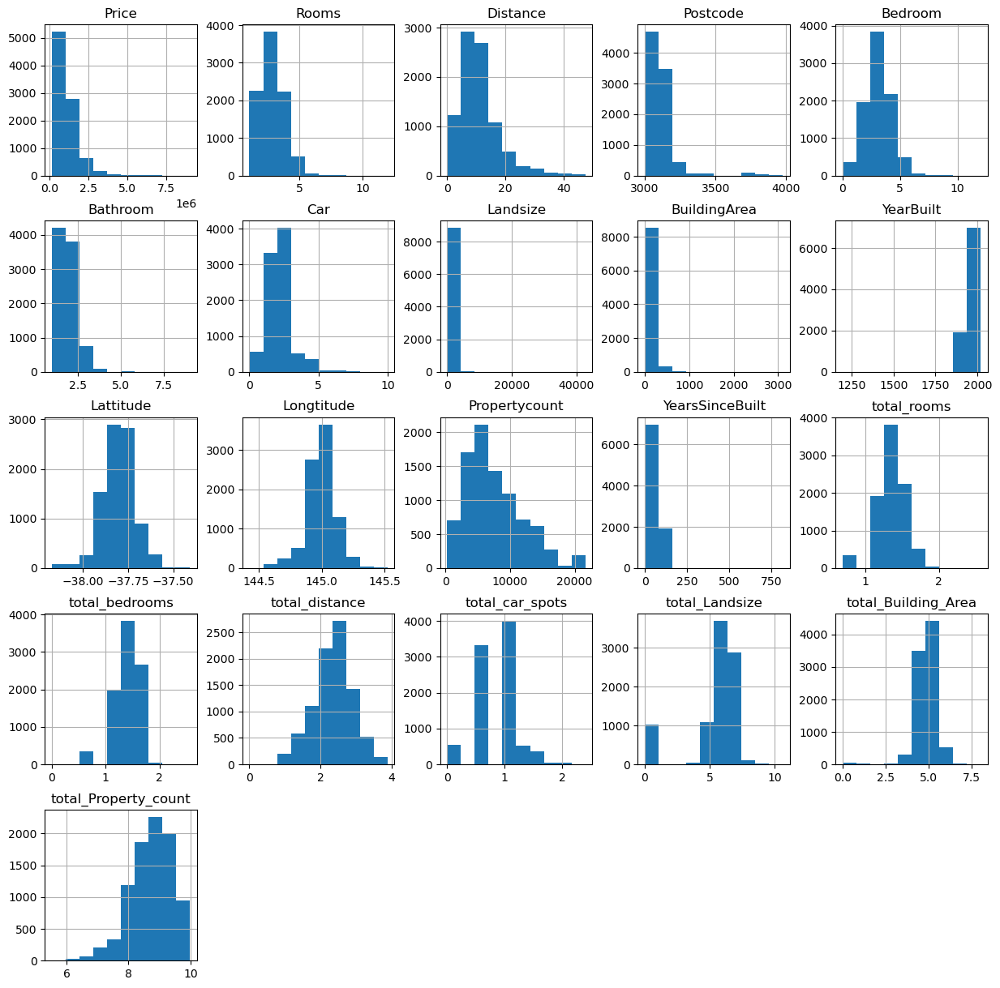

In [121]:
housing_pd.hist(figsize=(15,15))

### Include summary statistics of Property Prices based on Suburb

In [122]:
housing_pd.groupby(['Suburb'])['Price'].describe()

,count,mean,std,min,25%,50%,75%,max
Suburb,,,,,,,,
Abbotsford,39.0,1.126410e+06,3.255790e+05,470000.0,977500.00,1176500.0,1312500.00,1876000.0
Aberfeldie,29.0,1.462966e+06,7.581816e+05,380000.0,1150000.00,1350000.0,1740000.00,3900000.0
Airport West,52.0,7.668077e+05,1.579470e+05,450000.0,682500.00,771500.0,851500.00,1220000.0
Albanvale,3.0,5.403333e+05,2.983845e+04,506000.0,530500.00,555000.0,557500.00,560000.0
Albert Park,34.0,1.950985e+06,8.665201e+05,442500.0,1340000.00,1825000.0,2330000.00,4735000.0
Albion,27.0,6.280000e+05,1.766709e+05,185000.0,580000.00,600000.0,762500.00,840000.0
Alphington,18.0,1.446500e+06,7.270935e+05,330000.0,820000.00,1646250.0,1937500.00,2840000.0
Altona,34.0,8.223118e+05,3.328746e+05,391000.0,580000.00,747500.0,938750.00,1780000.0
Altona Meadows,12.0,6.694167e+05,1.207843e+05,417000.0,600000.00,675250.0,766500.00,810000.0


# Step 4. Finalise the current data-frame 

### Apply using one-hot encoding

In [123]:
housing_pd.info()

<class 'pandas.core.frame.DataFrame'>
Index: 8887 entries, 2 to 34856
Data columns (total 29 columns):
 #   Column                Non-Null Count  Dtype   
---  ------                --------------  -----   
 0   Price                 8887 non-null   float64 
 1   Suburb                8887 non-null   object  
 2   Address               8887 non-null   object  
 3   Rooms                 8887 non-null   int64   
 4   Type                  8887 non-null   object  
 5   Method                8887 non-null   object  
 6   Seller                8887 non-null   object  
 7   Distance              8887 non-null   float64 
 8   Postcode              8887 non-null   int32   
 9   Bedroom               8887 non-null   int32   
 10  Bathroom              8887 non-null   int32   
 11  Car                   8887 non-null   int32   
 12  Landsize              8887 non-null   float64 
 13  BuildingArea          8887 non-null   float64 
 14  YearBuilt             8887 non-null   float64 
 15  CouncilA

In [124]:
housing_pd['Type'].unique()

array(['h', 'u', 't'], dtype=object)

In [125]:
housing_pd['Method'].unique()

array(['S', 'SP', 'VB', 'PI', 'SA'], dtype=object)

In [126]:
housing_pd['Seller'].unique()

array(['Biggin', 'Nelson', 'Jellis', 'LITTLE', 'Kay', 'Collins',
       'Marshall', 'Brad', 'Maddison', 'Barry', 'Rendina', 'Harcourts',
       'hockingstuart', 'Buxton', 'Greg', 'RT', 'Cayzer', 'Brace',
       'Miles', 'Love', 'McGrath', 'Barlow', 'Village', 'Burnham',
       'Williams', 'Compton', 'FN', 'Jas', 'Raine&Horne', 'Hunter',
       'Hodges', 'Raine', 'Alexkarbon', 'McDonald', 'Stockdale',
       'Fletchers', 'Noel', 'Tim', 'Purplebricks', 'Ray', 'Moonee',
       'Edward', 'Gary', 'Chisholm', 'Philip', 'RW', 'Ascend',
       'Christopher', 'Mandy', 'Fletchers/One', 'Assisi', 'One',
       'Woodards', 'Bayside', 'C21', 'First', 'Beller', 'Matthew', 'Nick',
       'Lindellas', 'Allens', 'Sweeney', 'Bells', 'Trimson', 'YPA', 'GL',
       "Tiernan's", 'HAR', 'Walshe', 'Dingle', 'Chambers', 'Peter',
       'Grantham', 'hockingstuart/Advantage', "O'Donoghues", 'Ross',
       'Weast', 'Century', 'Kelly', 'Property', 'Thomson',
       "Private/Tiernan's", 'Australian', 'Anderson', '

### Feature Engineering

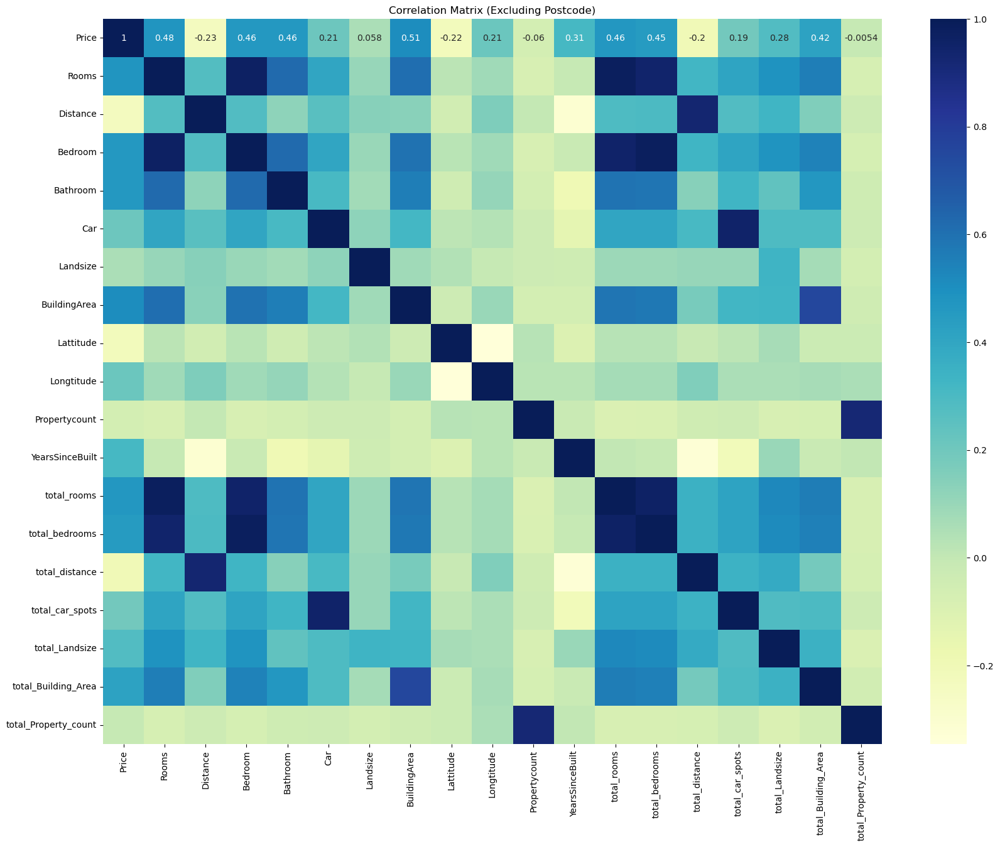

In [127]:
import seaborn as sns
import matplotlib.pyplot as plt


# Calculate the correlation matrix
plt.figure(figsize=(20,15))
sns.heatmap(housing_pd.drop(columns=['Postcode','YearBuilt']).select_dtypes(include=['float64', 'int64','int32']).corr(),annot=True,cmap='YlGnBu')
plt.title('Correlation Matrix (Excluding Postcode)')
plt.show()

In [128]:
# Calculate the correlation matrix)
plt.figure(figsize=(50,50))
housing_pd.select_dtypes(include=['float64', 'int64','int32']).corr().style.background_gradient(cmap='coolwarm')


,Price,Rooms,Distance,Postcode,Bedroom,Bathroom,Car,Landsize,BuildingArea,YearBuilt,Lattitude,Longtitude,Propertycount,YearsSinceBuilt,total_rooms,total_bedrooms,total_distance,total_car_spots,total_Landsize,total_Building_Area,total_Property_count
Price,1.000000,0.475074,-0.231212,0.046033,0.460880,0.463501,0.209464,0.058375,0.507284,-0.313664,-0.224255,0.212174,-0.059720,0.313664,0.464807,0.449965,-0.200705,0.192315,0.281927,0.420760,-0.005423
Rooms,0.475074,1.000000,0.276585,0.084236,0.964465,0.624070,0.401423,0.101158,0.606738,0.006935,0.018758,0.083016,-0.082797,-0.006935,0.982440,0.945133,0.326683,0.409017,0.489540,0.556616,-0.072524
Distance,-0.231212,0.276585,1.000000,0.489537,0.283460,0.122132,0.259374,0.138559,0.135509,0.313383,-0.055317,0.163941,-0.003247,-0.313383,0.295042,0.300166,0.927503,0.281084,0.327775,0.153750,-0.032835
Postcode,0.046033,0.084236,0.489537,1.000000,0.087286,0.111617,0.055531,0.069623,0.077091,0.089913,-0.195081,0.358005,0.032758,-0.089913,0.080216,0.082588,0.349899,0.065178,0.051185,0.062727,0.053741
Bedroom,0.460880,0.964465,0.283460,0.087286,1.000000,0.626493,0.405570,0.101035,0.595299,0.016310,0.022745,0.082671,-0.081392,-0.016310,0.948771,0.980629,0.331715,0.411033,0.483408,0.543966,-0.071530
Bathroom,0.463501,0.624070,0.122132,0.111617,0.626493,1.000000,0.310962,0.075939,0.553855,0.192914,-0.041859,0.109268,-0.058324,-0.192914,0.591149,0.587451,0.142671,0.330712,0.240078,0.466096,-0.037931
Car,0.209464,0.401423,0.259374,0.055531,0.405570,0.310962,1.000000,0.123498,0.317593,0.139255,0.015139,0.035589,-0.031285,-0.139255,0.402165,0.403471,0.308381,0.949871,0.294155,0.291533,-0.034189
Landsize,0.058375,0.101158,0.138559,0.069623,0.101035,0.075939,0.123498,1.000000,0.083229,0.037753,0.042484,-0.008196,-0.032548,-0.037753,0.095202,0.094479,0.101086,0.104635,0.334163,0.071773,-0.061157
BuildingArea,0.507284,0.606738,0.135509,0.077091,0.595299,0.553855,0.317593,0.083229,1.000000,0.059936,-0.034626,0.097635,-0.059024,-0.059936,0.587438,0.575446,0.177228,0.322833,0.331675,0.755142,-0.041191
YearBuilt,-0.313664,0.006935,0.313383,0.089913,0.016310,0.192914,0.139255,0.037753,0.059936,1.000000,0.100030,-0.026886,0.017224,-1.000000,-0.004237,0.004487,0.329722,0.209568,-0.096747,0.015163,-0.006204


<Figure size 5000x5000 with 0 Axes>

# Step 5. Spliting the final housing dataframe for the training, testing and validation data.

### We want to use Price for Predicting House Prices in Melbourne occuring in 2015-2017

In [129]:
# Where X is our features, dropping unnecessarily features
X = housing_pd.drop(['Price','Postcode'],axis=1).select_dtypes(include=['float64', 'int64','int32'])

# Where y is our Actual labels
y = housing_pd['Price']

### Train-Test-Validation Split

In [130]:
from sklearn.model_selection import train_test_split

# Split from the full dataset into training and testing sets (Using 20% from the full dataset for testing)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Split from training data into training and validation sets (Using 20% from the training set for validation)
X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=0.2, random_state=42) 

### Apply normalisation on X (both the training and test set)

One reason this is important is because the variables are multiplied by the model weights. So the scale of the outputs and the scale of the gradients are affected by the scale of the inputs.

Although a model might converge without normalization, normalization makes training much more stable.

In [131]:
from sklearn.preprocessing import MinMaxScaler

# fit scaler on training data
norm = MinMaxScaler().fit(X_train)

# transform training data
X_train_norm = norm.transform(X_train)

# transform testing data
X_test_norm = norm.transform(X_test)

# transform validation data
X_val_norm = norm.transform(X_val)


In [132]:
X_train_norm.shape,X_val_norm.shape,X_test_norm.shape

((5687, 19), (1422, 19), (1778, 19))

## Use the models

In [133]:
from sklearn.linear_model import LinearRegression, Ridge, Lasso, ElasticNet
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import GradientBoostingRegressor,AdaBoostRegressor
from xgboost import XGBRegressor
from sklearn.neighbors import KNeighborsRegressor
from sklearn.svm import SVR
from sklearn.tree import DecisionTreeRegressor
from sklearn import linear_model

#### Model training

In [134]:
#Linear Regression
lr = LinearRegression()
lr.fit(X_train_norm,y_train)

#Random Forest
SEED = 1
# Instantiate a random forests regressor 'rf' 400 estimators
rf = RandomForestRegressor(n_estimators=400,min_samples_leaf=0.12,random_state=SEED)
rf.fit(X_train_norm,y_train)

#Gradient Boosting Regressor
xgr = GradientBoostingRegressor()
xgr.fit(X_train_norm,y_train)

#Support Vector Machine (Regression)
svr = SVR(kernel='rbf')
svr.fit(X_train_norm,y_train)

#K-Nearest Neighbour 
knn = KNeighborsRegressor()
knn.fit(X_train_norm,y_train)

#XGB
xgb = XGBRegressor()
xgb.fit(X_train_norm,y_train)

#Logistic Regression
logr = linear_model.LogisticRegression()
logr.fit(X_train_norm,y_train)

#Decision Tree
dt = DecisionTreeRegressor(max_depth=4, min_samples_leaf = 0.1,random_state=3)
## Fit the decision Tree
dt.fit(X_train_norm,y_train)



C:\Users\Michael Le\anaconda3\Lib\site-packages\sklearn\linear_model\_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


DecisionTreeRegressor(max_depth=4, min_samples_leaf=0.1, random_state=3)

### Prediction on the Test Data

In [135]:
y_pred1 = lr.predict(X_test_norm)
y_pred2 = rf.predict(X_test_norm)
y_pred3 = xgr.predict(X_test_norm)
y_pred4= svr.predict(X_test_norm)
y_pred5= knn.predict(X_test_norm)
y_pred6 = xgb.predict(X_test_norm)
y_pred7 = logr.predict(X_test_norm)
y_pred8 = dt.predict(X_test_norm)

### Evaluating the Algorithm

In [136]:
from sklearn import metrics

## Computing their R squared values on the testing data

In [137]:
score1 = metrics.r2_score(y_test,y_pred1)
score2 = metrics.r2_score(y_test,y_pred2)
score3 = metrics.r2_score(y_test,y_pred3)
score4 = metrics.r2_score(y_test,y_pred4)
score5 = metrics.r2_score(y_test,y_pred5)
score6 = metrics.r2_score(y_test,y_pred6)
score7 = metrics.r2_score(y_test,y_pred7)
score8 = metrics.r2_score(y_test,y_pred8)

In [138]:
final_data = pd.DataFrame({'Models':['LR','RF','GBR','SVR','KNN','XGB','LogR','DT'],"R2_SCORE":[score1,score2,score3,score4,score5,score6,score7,score8]})
final_data

,Models,R2_SCORE
0,LR,0.647142
1,RF,0.392599
2,GBR,0.823403
3,SVR,-0.076924
4,KNN,0.752126
5,XGB,0.855932
6,LogR,0.373826
7,DT,0.439736


<Axes: xlabel='Models', ylabel='R2_SCORE'>

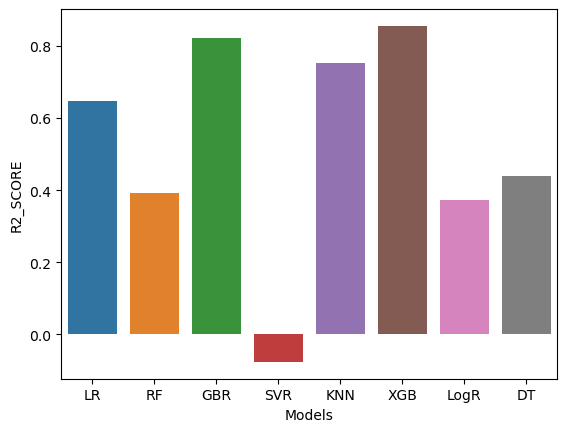

In [139]:
sns.barplot(final_data, x="Models", y="R2_SCORE")

### Similarly for the validation data

In [140]:
y_pred1 = lr.predict(X_val_norm)
y_pred2 = rf.predict(X_val_norm)
y_pred3 = xgr.predict(X_val_norm)
y_pred4= svr.predict(X_val_norm)
y_pred5= knn.predict(X_val_norm)
y_pred6 = xgb.predict(X_val_norm)
y_pred7 = logr.predict(X_val_norm)
y_pred8 = dt.predict(X_val_norm)

In [141]:
score1 = metrics.r2_score(y_val,y_pred1)
score2 = metrics.r2_score(y_val,y_pred2)
score3 = metrics.r2_score(y_val,y_pred3)
score4 = metrics.r2_score(y_val,y_pred4)
score5 = metrics.r2_score(y_val,y_pred5)
score6 = metrics.r2_score(y_val,y_pred6)
score7 = metrics.r2_score(y_val,y_pred7)
score8 = metrics.r2_score(y_val,y_pred8)

In [142]:
final_data = pd.DataFrame({'Models':['LR','RF','GBR','SVR','KNN','XGB','LogR','DT'],"R2_SCORE":[score1,score2,score3,score4,score5,score6,score7,score8]})
final_data

,Models,R2_SCORE
0,LR,0.399687
1,RF,0.292439
2,GBR,0.737656
3,SVR,-0.065309
4,KNN,0.653238
5,XGB,0.761301
6,LogR,0.291238
7,DT,0.333638


<Axes: xlabel='Models', ylabel='R2_SCORE'>

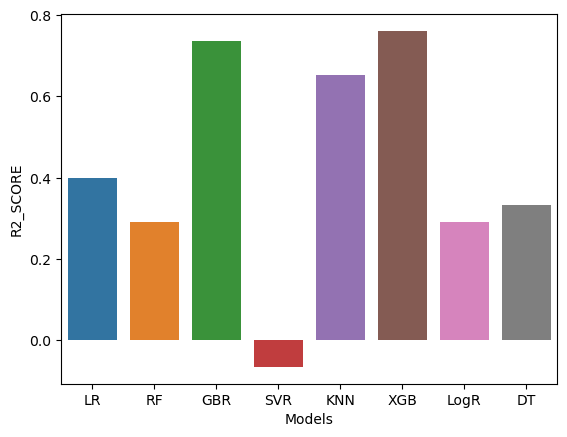

In [143]:
sns.barplot(final_data, x="Models", y="R2_SCORE")

## In addition Compute their mean square errors for the training, testing and validation data

In [144]:
from sklearn.metrics import mean_squared_error as mse

###  Refer from this link https://encord.com/glossary/mean-square-error-mse/#:~:text=By%20squaring%20the%20differences%2C%20the,values%2C%20reflecting%20better%20overall%20performance.

In [145]:
#Regression
print(mse(lr.predict(X_train_norm),y_train,squared=False), mse(lr.predict(X_test_norm),y_test,squared=False),mse(lr.predict(X_val_norm),y_val,squared=False))

#X-Gradident Boost 
print(mse(xgb.predict(X_train_norm),y_train,squared=False), mse(xgb.predict(X_test_norm),y_test,squared=False),mse(xgb.predict(X_val_norm),y_val,squared=False))

#Support Vector Machine (Regression)
print(mse(svr.predict(X_train_norm),y_train,squared=False), mse(svr.predict(X_test_norm),y_test,squared=False),mse(svr.predict(X_val_norm),y_val,squared=False))

#K-Nearest Neighbour 
print(mse(knn.predict(X_train_norm),y_train,squared=False), mse(knn.predict(X_test_norm),y_test,squared=False),mse(knn.predict(X_val_norm),y_val,squared=False))

#Random Forest
print(mse(rf.predict(X_train_norm),y_train,squared=False), mse(rf.predict(X_test_norm),y_test,squared=False),mse(rf.predict(X_val_norm),y_val,squared=False))

#XB Regressor 
print(mse(xgr.predict(X_train_norm),y_train,squared=False), mse(xgr.predict(X_test_norm),y_test,squared=False),mse(xgr.predict(X_val_norm),y_val,squared=False))

#Logistic Regression
print(mse(logr.predict(X_train_norm),y_train,squared=False), mse(logr.predict(X_test_norm),y_test,squared=False),mse(logr.predict(X_val_norm),y_val,squared=False))

#Decision Tree
print(mse(dt.predict(X_train_norm),y_train,squared=False), mse(dt.predict(X_test_norm),y_test,squared=False),mse(dt.predict(X_val_norm),y_val,squared=False))


410633.4248216941 368200.9232848043 587325.6764938374
88546.50019838315 235271.008596609 370352.56048384035
704566.4985144269 643246.6636726093 782398.6216519759
291767.14881238574 308603.23464688746 446381.2109417757
539446.9730599606 483084.13654151093 637634.8561164219
260232.37581587312 260481.32835343026 388262.84433562134
552497.4888820031 490492.71611071157 638176.0200953549
519039.6683264978 463961.0450302147 618793.0343405453


### Conclusion

|Model | Description |
| --- | --- | 
|Linear Regression (LR)| Good for baseline and linear problems|
|Random Forest (RF)| Great for capturing feature interactions and nonlinearities, robust to overfitting.|
|Gradient Boosting (GBR, XGB)| Powerful but requires careful tuning.|
|Support Vector Regressor (SVR)| Good for smaller datasets with non-linear relationships|
|K-Nearest Neighbors (KNN)| Simple, works well for small datasets|
|XGBoost (XGB)| Usually outperforms other models on complex datasets.|
|Logistic Regression (LogR)| Used for binary classification, estimating the probability that a given input belongs to a particular class using the logistic (sigmoid) function.|
|Decision Tree| An advantage of decision trees is their simplicity and interpretability, while a disadvantage is their tendency to overfit the data, especially with complex datasets.|

## Huge credit for this project.

#### Author: DanB (Melbourne Housing Snapshot)
#### NeuralNine: https://www.youtube.com/watch?v=Wqmtf9SA_kk&t=676s
#### Greg Hogg: https://www.youtube.com/watch?v=_-UCcuB8nbw